<a href="https://colab.research.google.com/github/ougrid/my-knowledge-resource/blob/master/%5B20240127%5D_ANS_Coding_for_AI_Industrial_Application.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Coding for AI Industrial Application

## เนื้อหา
- OpenCV
- Pre-trained Model
- YOLOv8

## OpenCV (Open Source Computer Vision Library)

- เป็น package สำหรับการทำงานทางด้าน Computer vision
- มีฟังก์ชันสำหรับการทำงานทางด้าน Computer vision และ imager processing มากมาย
- เหมาะกับการเริ่มต้นเรียนรู้การทำงานทางด้าน Computer vision และ Image procession


In [ ]:
import cv2

In [ ]:
!nvidia-smi

Sat Jan 27 02:30:39 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   44C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

###การอ่านภาพ แสดงผล และบันทึกภาพ

In [ ]:
!rm -rf demoimages
!git clone https://github.com/pingkung/demoimages.git

Cloning into 'demoimages'...
remote: Enumerating objects: 19, done.
remote: Counting objects: 100% (19/19), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 19 (delta 5), reused 16 (delta 2), pack-reused 0
Receiving objects: 100% (19/19), 826.66 KiB | 6.08 MiB/s, done.
Resolving deltas: 100% (5/5), done.


- การอ่านภาพเข้ามาในโปรแกรมด้วย openCV

In [ ]:
import os
print(os.path.join('demoimages', 'color_image.png'))

demoimages/color_image.png


In [ ]:
import cv2
import os

img = cv2.imread(os.path.join('demoimages', 'color_image.png'))

# cv2.imshow('Show Image', img)

- การแสดงผลภาพด้วย openCV

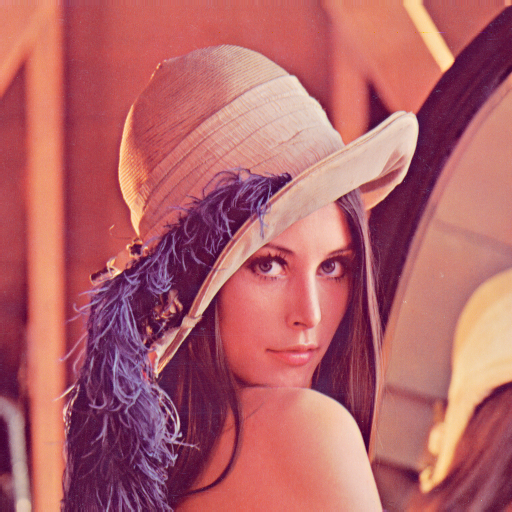

In [ ]:
from google.colab.patches import cv2_imshow

cv2_imshow(img)

- เรายังสามารถ save รูปภาพได้อีกด้วย

In [ ]:
cv2.imwrite('saveImg.png', img)

True

### ระบบภาพใน openCV และการใช้งาน

- ที่จริงแล้ว ภาพ ก็คือข้อมูล matrix ที่ระบุความเข้มของสีแต่ละสี
- ซึ่งใน openCV นั้น จะเรียง channel สีคือ B(blue) G(green) R(red)

(227, 222, 3)


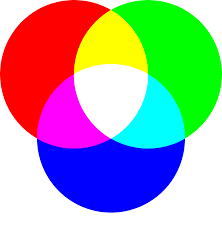

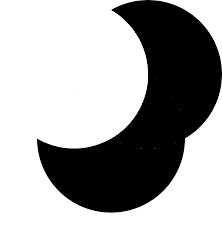

In [ ]:
import cv2

img = cv2.imread(os.path.join('demoimages', 'segment.png'))
print(img.shape)
cv2_imshow(img)
# cv2_imshow(img[:,:,0])
# cv2_imshow(img[:,:,1])
# cv2_imshow(img[:,:,2])

- ดังนั้น เราสามารถสร้างภาพขึ้นมาได้เช่นกัน

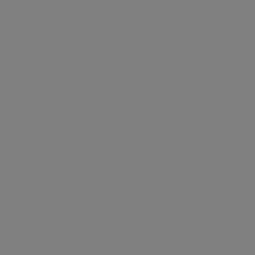

In [ ]:
import numpy as np
npImg = np.full((255,255,3),128,float)
cv2_imshow(npImg)

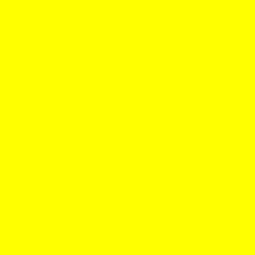

In [ ]:
npBlue = np.full((255,255),0,float)
npGreen = np.full((255,255),255,float)
npRed = np.full((255,255),255,float)

npImg = cv2.merge([npBlue, npGreen, npRed])
cv2_imshow(npImg)

- แต่ในบางครั้ง การทำงานเกี่ยวกับรูปภาพ เราอาจทำงานบนภาพสีเทา (Gray Scale Image) หรือภาพขาว-ดำ (Binary Image)
- ใน openCV เราสามารถแปลงภาพสี ให้เป็นภาพสีเทา หรือภาพขาวดำได้โดย

(512, 512, 3)


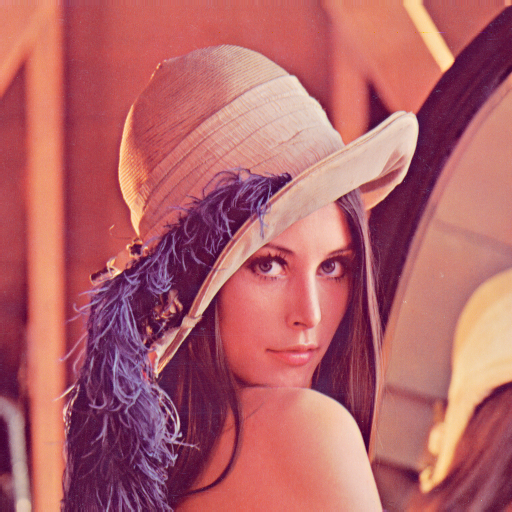

(512, 512)


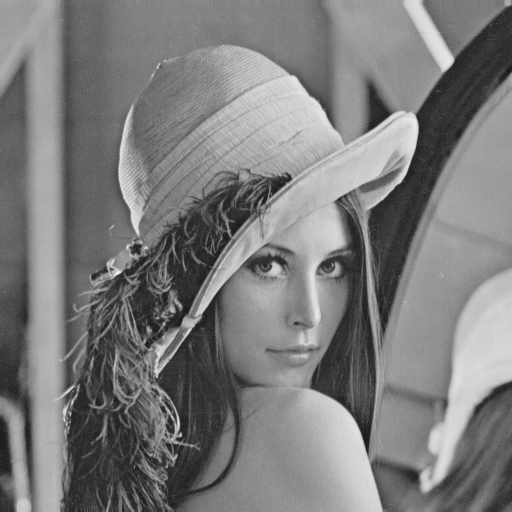

(512, 512)


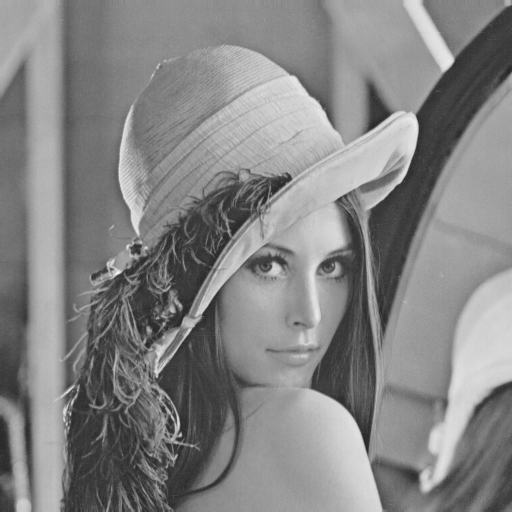

In [ ]:
img = cv2.imread(os.path.join('demoimages', 'color_image.png'))
print(img.shape)
cv2_imshow(img)
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
print(img.shape)
cv2_imshow(img)
img = cv2.imread(os.path.join('demoimages', 'color_image.png'), 0)
print(img.shape)
cv2_imshow(img)

- โดย openCV จะทำการคำนวณสีเทาด้วยสมการ grayscale image = ( (0.3 * R) + (0.59 * G) + (0.11 * B) )
- [imread flag](https://docs.opencv.org/4.x/d8/d6a/group__imgcodecs__flags.html#gga61d9b0126a3e57d9277ac48327799c80af660544735200cbe942eea09232eb822)
- หากเราต้องการภาพขาว-ดำ หรือ binary image เราจะทำการแปลงจากภาพสีเทาอีกทีหนึ่ง โดย

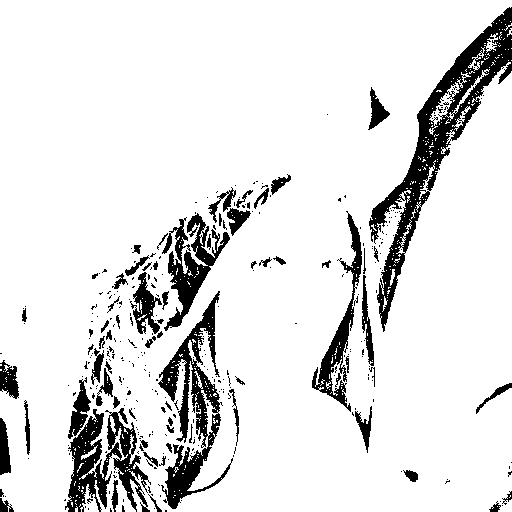

In [ ]:
_, binaryImg = cv2.threshold(img, 64, 255, cv2.THRESH_BINARY)
cv2_imshow(binaryImg)

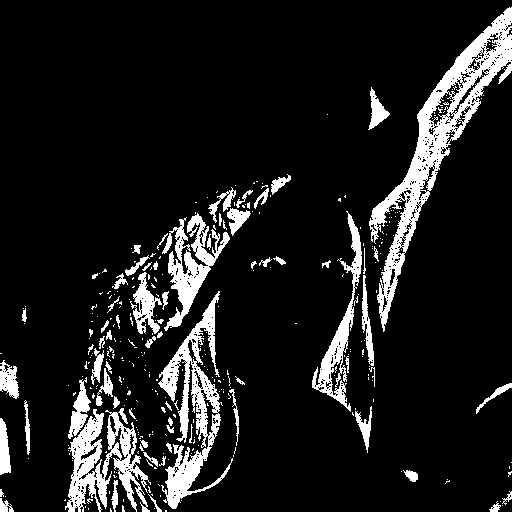

In [ ]:
_, binaryImg = cv2.threshold(img, 64, 255, cv2.THRESH_BINARY_INV)
cv2_imshow(binaryImg)

### การวาดและเขียนข้อความลงในรูปภาพ

- ใน openCV เราสามารถทำการวาดรูปทรงต่างๆลงไปบนภาพที่เราต้องการได้

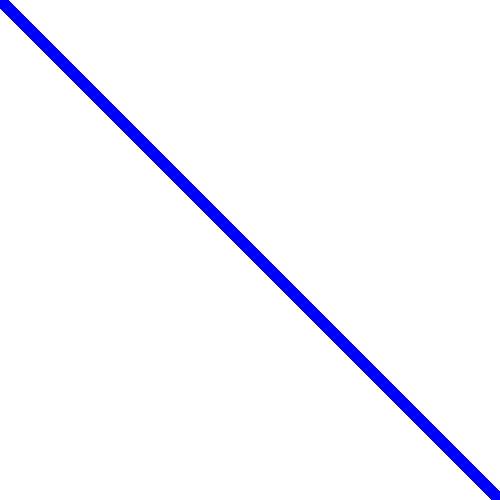

In [ ]:
import numpy as np

img = np.full((500,500,3),255,float)

#      image, start point, end point, color, thickness
cv2.line(img,(0,0),(500,500),(255,0,0),10)
cv2_imshow(img)

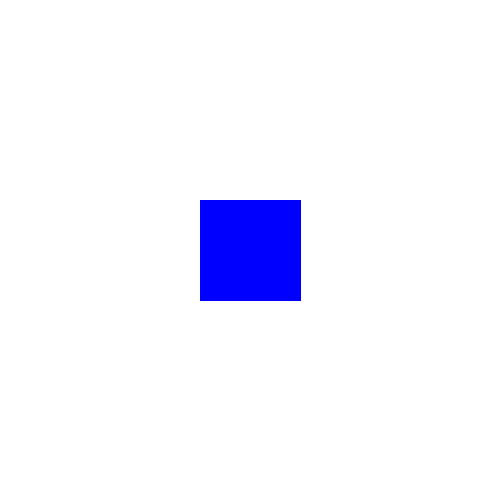

In [ ]:
img = np.full((500,500,3),255,float)

#image, Vertex of the rectangle, Vertex of the rectangle opposite to pt1, color, thickness
cv2.rectangle(img,(200,200),(300,300),(255,0,0),-100)
cv2_imshow(img)

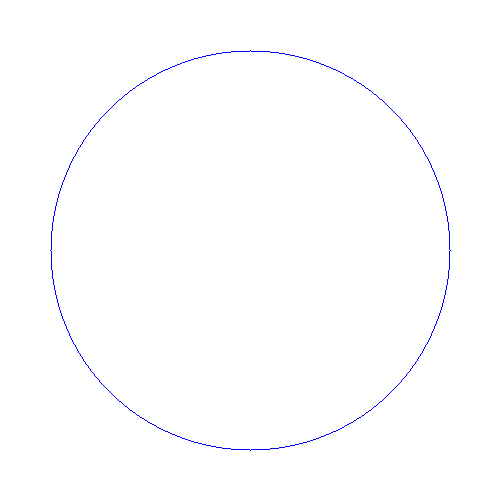

In [ ]:
img = np.full((500,500,3),255,float)

#image, center of circle, radius, color, thickness
cv2.circle(img,(250,250), 200, (255,0,0), 1)
cv2_imshow(img)

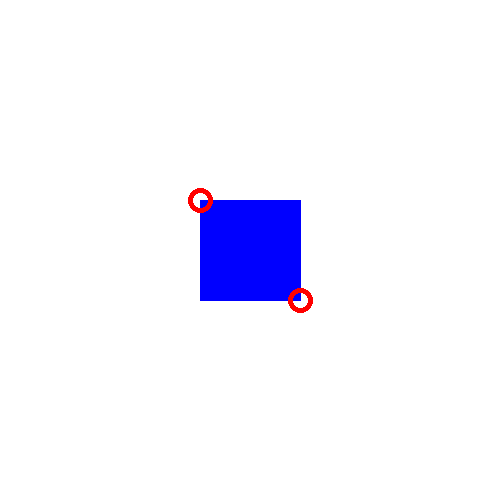

In [ ]:
img = np.full((500,500,3),255,float)

cv2.rectangle(img,(200,200),(300,300),(255,0,0),-1)
cv2.circle(img,(200,200), 10, (0,0,255), 3)
cv2.circle(img,(300,300), 10, (0,0,255), 3)
cv2_imshow(img)

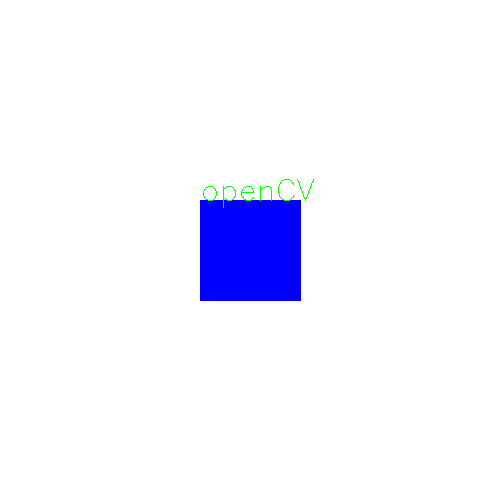

In [ ]:
img = np.full((500,500,3),255,float)

cv2.rectangle(img,(200,200),(300,300),(255,0,0),-1)

# image, text, Bottom-left corner of the text string in the image, font, fontScale, color, thickness
cv2.putText(img,'openCV',(200,200),cv2.FONT_HERSHEY_SIMPLEX,1,(0,255,0),1)
cv2_imshow(img)

- FONT_HERSHEY_SIMPLEX 		normal size sans-serif font
- FONT_HERSHEY_PLAIN 		small size sans-serif font
- FONT_HERSHEY_DUPLEX 		normal size sans-serif font (more complex than - FONT_HERSHEY_SIMPLEX )
- FONT_HERSHEY_COMPLEX 		normal size serif font
- FONT_HERSHEY_TRIPLEX 		normal size serif font (more complex than - FONT_HERSHEY_COMPLEX )
- FONT_HERSHEY_COMPLEX_SMALL 	smaller version of - FONT_HERSHEY_COMPLEX
- FONT_HERSHEY_SCRIPT_SIMPLEX 	hand-writing style font
- FONT_HERSHEY_SCRIPT_COMPLEX 	more complex variant of - FONT_HERSHEY_SCRIPT_SIMPLEX

### แบบฝึกหัดที่ 1

1. ให้ทำการสร้างรูปด้วย numpy โดยให้มีสีขาวทั้งภาพ ขนาด 500x500 pixel

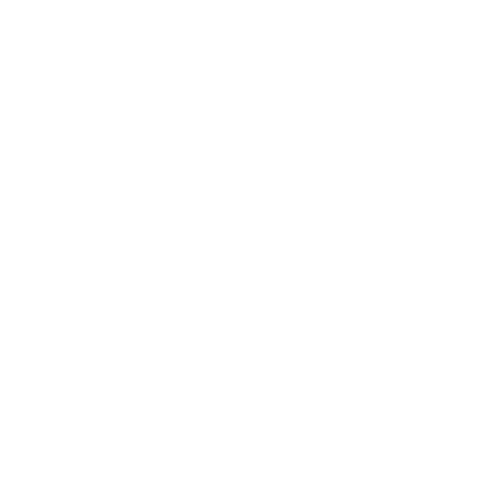

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

img = np.full((500,500,3), 255, float)
cv2_imshow(img)


2. ทำการวาดรูปสี่เหลี่ยมขนาด 400x400 ลงกึ่งกลางภาพ โดยมีสีเขียว และเป็นสีทึบ

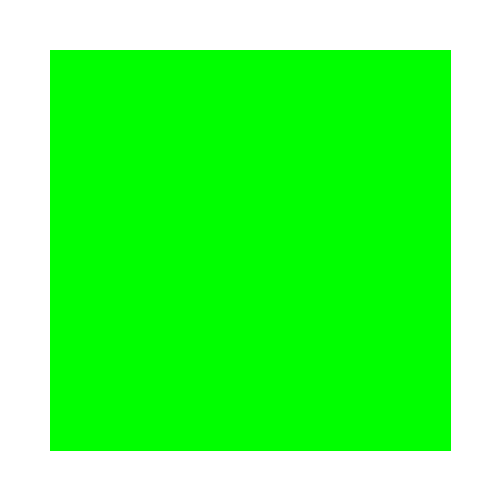

In [ ]:
cv2.rectangle(img, (50,50), (450,450), (0,255,0), -1)
cv2_imshow(img)

3. ทำการเขียนข้อความ "We love Python" ด้วยอักษรสีแดง ลงกึ่งกลางภาพ

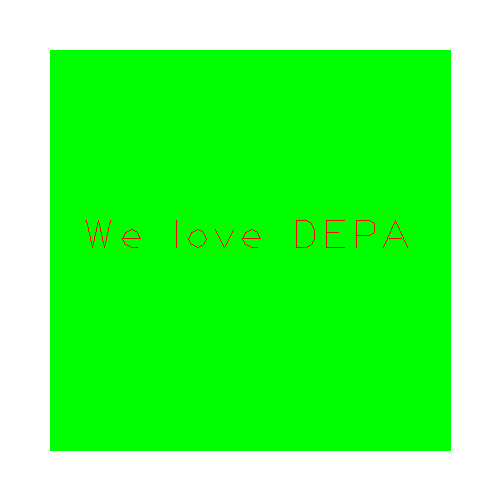

In [ ]:
imgText = img.copy()

cv2.putText(imgText, 'We love DEPA', (80,250), cv2.FONT_HERSHEY_PLAIN, 3, (0,0,255), 1)
cv2_imshow(imgText)

### การเลือกบางส่วนของภาพ (Crop)

- เนื่องจากรูปภาพนั้น คือ matrix ดังนั้น เราสามารถเลือกบางส่วนของภาพ (Crop) ได้โดยการเลือก Index ของ matrix นั่นเอง

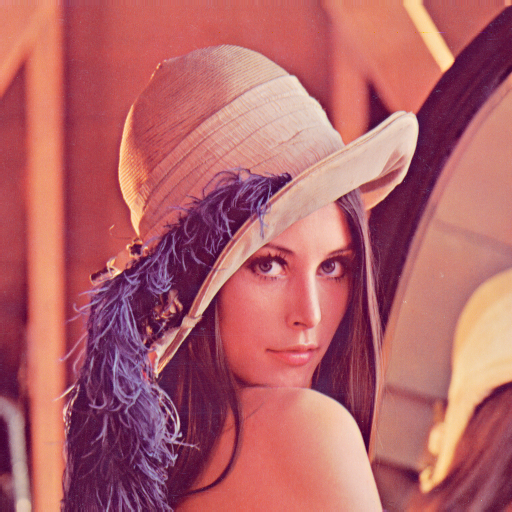

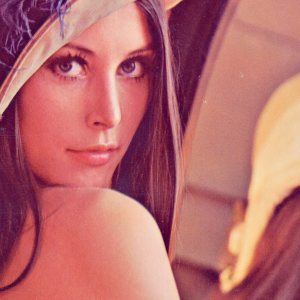

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread(os.path.join('demoimages', 'color_image.png'))
cv2_imshow(img)

img_crop = img[200:500,200:500]
cv2_imshow(img_crop)

### การหาเส้นรอบรูป

- ใน OpenCV มี function ที่ใช้ในการหาเส้นรอบรูปของวัตุที่อยู่ในภาพ

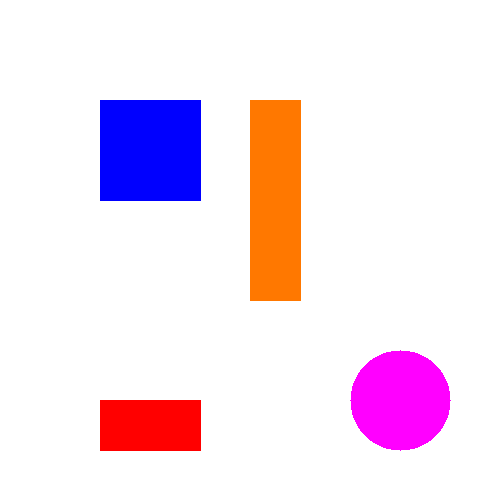

In [ ]:
img = cv2.imread(os.path.join('demoimages', 'contour.png'))
cv2_imshow(img)

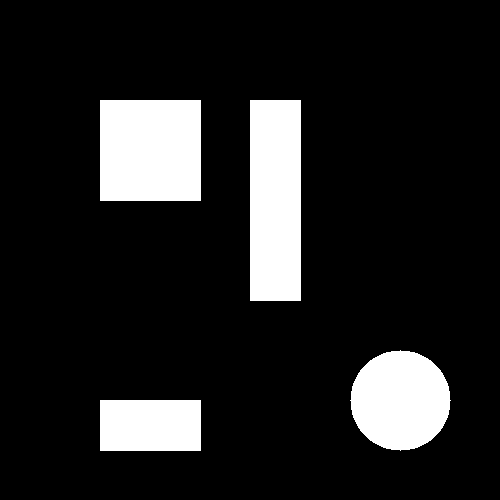

In [ ]:
imgray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
_, imbinary = cv2.threshold(imgray, 150, 255, cv2.THRESH_BINARY_INV)
cv2_imshow(imbinary)

In [ ]:
contours, hierarchy = cv2.findContours(imbinary, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

- contour retrieval algorithm [link](https://docs.opencv.org/master/d3/dc0/group__imgproc__shape.html#ga819779b9857cc2f8601e6526a3a5bc71)
- contour approximation algorithm [link](https://docs.opencv.org/master/d3/dc0/group__imgproc__shape.html#ga4303f45752694956374734a03c54d5ff)

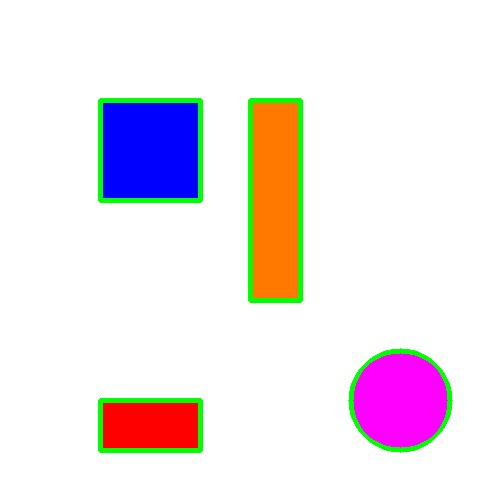

In [ ]:
imgCon = img.copy()
cv2.drawContours(imgCon, contours, -1, (0,255,0), 3)
cv2_imshow(imgCon)

5000.0
7704.0
10000.0
10000.0


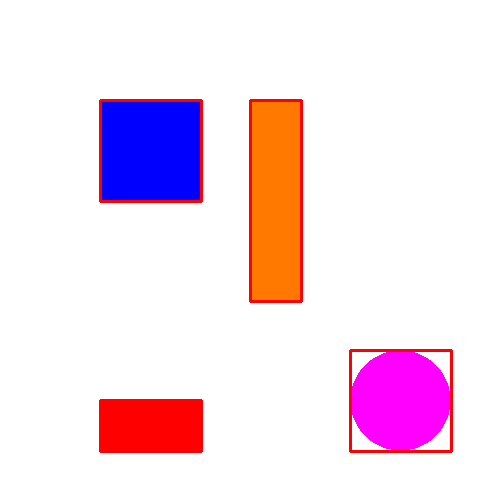

In [ ]:
for cnt in contours:
  x,y,w,h = cv2.boundingRect(cnt)
  img = cv2.rectangle(img,(x,y),(x+w,y+h),(0,0,255),2)
  print(cv2.contourArea(cnt))

cv2_imshow(img)

### แบบฝึกหัดที่ 2

1. อ่านภาพ `coin1.jpg`
2. ทำการตีกรอบล้อมรอบเหรียญ พร้อมทั้งพิม `coin: [coin index]`
3. save รูปที่ได้ทำการตีกรอบแล้ว
3. crop เหรียญแต่ละรูป

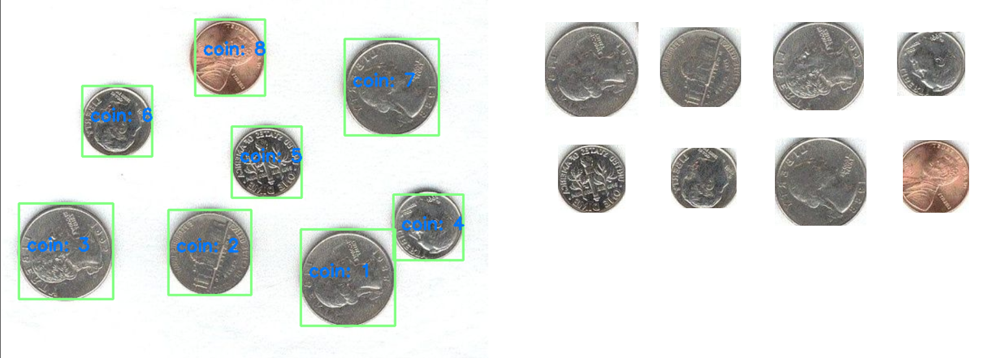

1. อ่านภาพชื่อ coin1.jpg

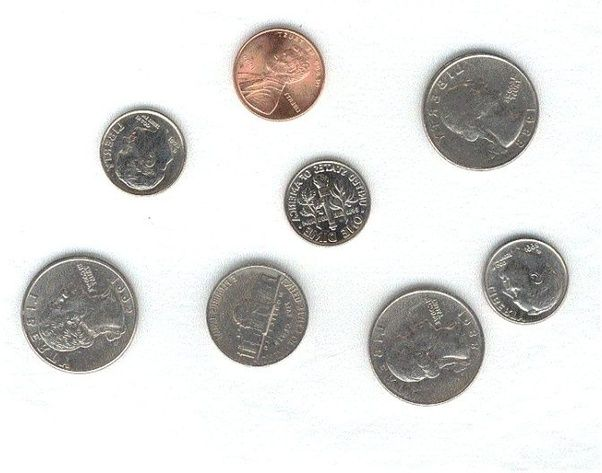

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

coinImg = cv2.imread('/content/demoimages/coin1.jpg')
cv2_imshow(coinImg)

2. แปลงภาพให้อยู่ในรูปแบบที่เหมาะสม ก่อนทำการหาเส้นรอบรูป

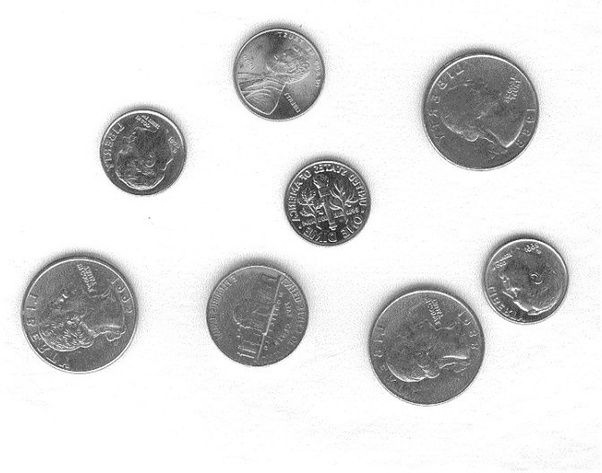

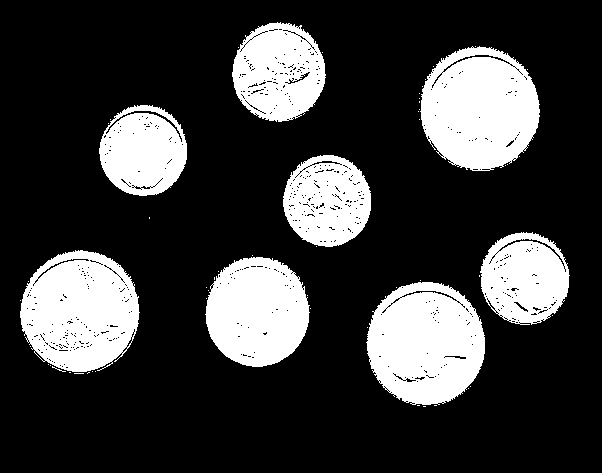

In [ ]:
coinGray = cv2.cvtColor(coinImg, cv2.COLOR_BGR2GRAY)
cv2_imshow(coinGray)

_, coinBW = cv2.threshold(coinGray, 200, 255, cv2.THRESH_BINARY_INV)

cv2_imshow(coinBW)

3. หาเส้นรอบรูปของเหรียญ

In [ ]:
contours, _ = cv2.findContours(coinBW, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

4. วาดกรอบสี่เหลี่ยม พร้อมทั้งเขียนข้อมูลลำดับเหรียญ save ผลลัพธ์ และทำการ crop เฉพาะเหรียญ

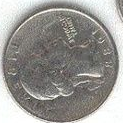

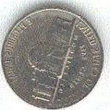

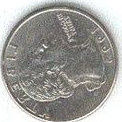

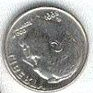

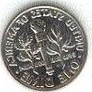

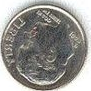

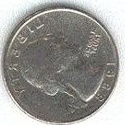

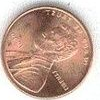

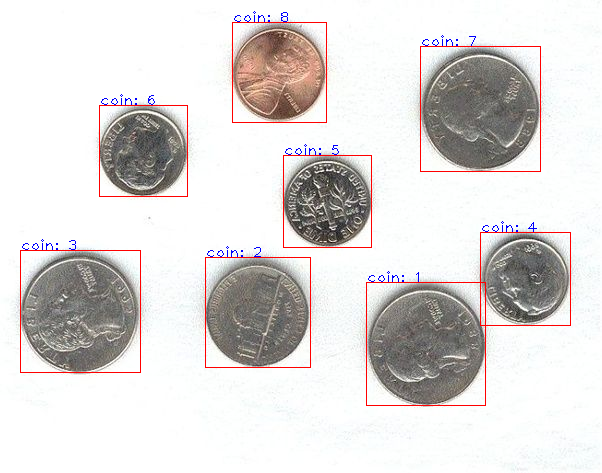

In [ ]:
coinIndex = 1

contourImg = coinImg.copy()

for cnt in contours:
  if (cv2.contourArea(cnt)) < 1000:
    continue
  x,y,w,h = cv2.boundingRect(cnt)
  cv2.rectangle(contourImg, (x,y), (x+w, y+h), (0,0,255), 1)
  cv2.putText(contourImg, f'coin: {coinIndex}', (x,y), cv2.FONT_HERSHEY_PLAIN, 1, (255,0,0), 1)
  coinIndex += 1
  cropImg = coinImg[y:y+h, x:x+h]
  cv2_imshow(cropImg)

cv2_imshow(contourImg)

### Image Convolution

- การทำ covolution บนรูปภาพ คือการนำ matrix หรือที่เรียกว่า Kernel หรือ Windows หรือ mask มาทำการคูณในแต่ละ Pixel ของรูปภาพ และทำการเลื่อน kernel ไปจนครบทั้งรูปภาพ

![alt text](https://drive.google.com/uc?id=15ShgYZQVuwwVfx06vYPzYACj8K-PfbNM)

- ลองพิจารณา Kernal ต่อไปนี้

$$\begin{pmatrix} 1&2&1\\
0&0&0\\
-1&-2&-1
\end{pmatrix} $$
และ
$$\begin{pmatrix} 1&0&-1\\
2&0&-2\\
1&0&-1
\end{pmatrix} $$

![alt text](https://drive.google.com/uc?id=1oYlD_yRQPTMZ_6IB2LfiUnblC2BDhgPt)

In [ ]:
import numpy as np
from google.colab.patches import cv2_imshow
from scipy import signal

maskX = np.array([[1,0,-1],[2,0,-2],[1,0,-1]])

imgL = np.full((200,100),0)
imgR = np.full((200,100),255)

img = np.concatenate((imgL,imgR),axis=1)
cv2_imshow(img)
print()
cv2_imshow(signal.convolve2d(img,maskX))


![alt text](https://drive.google.com/uc?id=1lcirP1XP-xQNSulrZs5g-eXqbzx3eiH3)

In [ ]:
import numpy as np
from google.colab.patches import cv2_imshow
from scipy import signal

maskY = np.array([[1,2,1],[0,0,0],[-1,-2,-1]])

imgL = np.full((100,200),0)
imgR = np.full((100,200),255)

img = np.concatenate((imgL,imgR),axis=0)
cv2_imshow(img)
print()
cv2_imshow(signal.convolve2d(img,maskY))


- สิ่งที่เราทำไป คือกระบวนการ convolution ซึ่ง kernel ที่เราใช้นั้น ชื่อว่า Solbel
- หรือที่รู้จักในชื่อ Sobel mask
- ซึ่งใช้สำหรับการทำ edge detection
- ดังนั้น หากเราต้องการทำ edge detection สำหรับภาพ เราจะต้องทำทั้ง 2 แกน และนำผลลัพธ์มารวมกัน
- โดยการรวมนั้น จะรวมแต่ละ pixel ด้วยสมการ Edge gradient
$$
G = \sqrt{G^2_x+G^2_y}
$$
- ซึ่งใน openCV ก็มี funtion ที่ให้เราสามารถทำ Sobel edge detection ได้

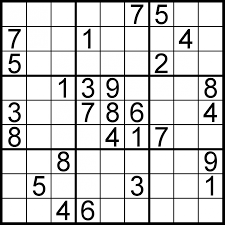

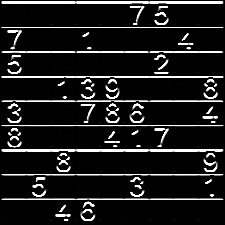

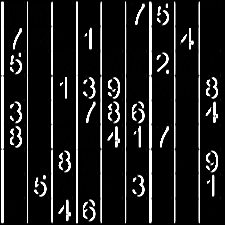

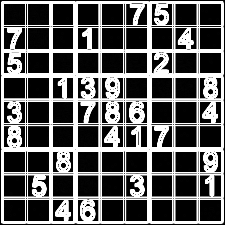

In [ ]:
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread(os.path.join('demoimages', 'sudoku.png'))
cv2_imshow(img)

sy = cv2.Sobel(img, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=3)
sx = cv2.Sobel(img, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=3)

cv2_imshow(sy)
cv2_imshow(sx)

edge = np.hypot(sx,sy)
cv2_imshow(edge)

### Face detection

- สำหับการตรวจจับใบหน้าด้วย openCV นั้น มีมากมายหลายวิธีการ
- ในวันนี้ จะแนะนำวิธีการที่ง่ายและเป็นที่นิยม ชื่อว่า Haar-cascade หรือ Haar like features
- ซึ่งจะเป็นการ matching pattern ที่ได้ทำการเรียนรู้มาแล้ว โดยเราสามารถนำมาใช้ได้เลย

![alt text](https://drive.google.com/uc?id=10_WjN_1sCl248BoUWn9usFhRloj2vbIj)

In [ ]:
import cv2

faceCascade = cv2.CascadeClassifier('/content/demoimages/haarcascade_frontalface_default.xml')

- หลังจากโหลด model ของ Face ที่มีการเทรนมาแล้วนั้น เราก็จะสามารถใช้ Model นี้ในการ detect หรือตรวจหาใบหน้าได้
- แต่ใบหน้านั้น จะต้องอยู่ในโหมดสีเทา

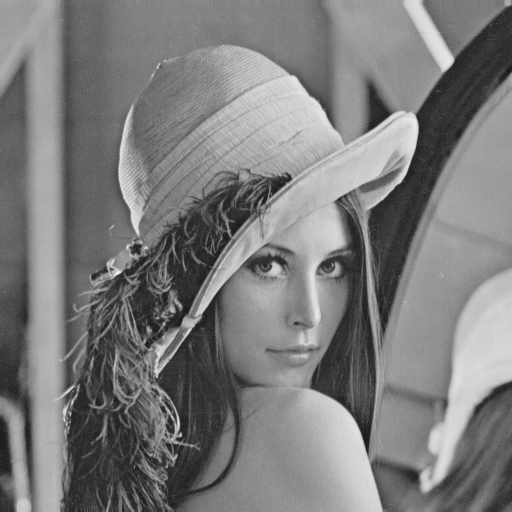

[[217 201 173 173]]


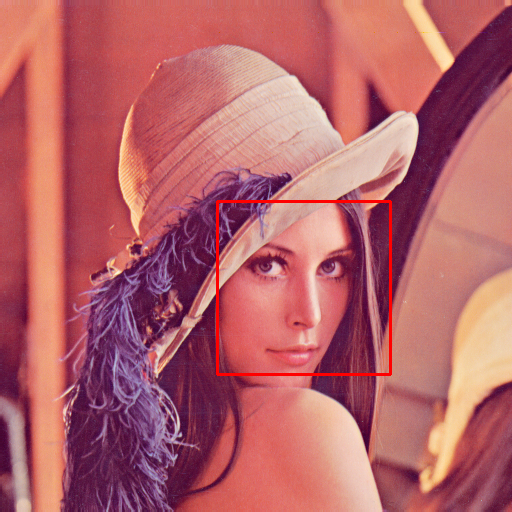

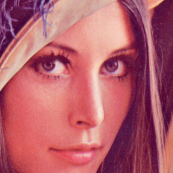

In [ ]:
img = cv2.imread(os.path.join('demoimages', 'color_image.png'))
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

cv2_imshow(img_gray)

faces = faceCascade.detectMultiScale(img_gray)

print(faces)
img_faces = []
img_face = img.copy()

for x,y,w,h in faces:
  cv2.rectangle(img_face,(x,y),(x+w,y+h),(0,0,255),2)
  img_faces.append(img[y:y+h,x:x+w])

cv2_imshow(img_face)

for imf in img_faces:
  cv2_imshow(imf)


###แบบฝึกหัดที่ 3

1. ทำการอ่านภาพ american.jpg และทำการปรับเป็นภาพ gray scale

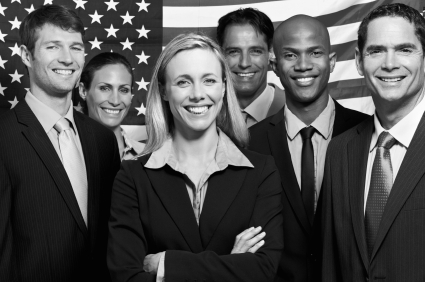

In [ ]:
img = cv2.imread('/content/demoimages/american.jpg')
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

cv2_imshow(img_gray)




2. ทำการตรวจจับใบหน้าในภาพ

In [ ]:
faces = faceCascade.detectMultiScale(img_gray)

print(faces)


[[ 33  24  60  60]
 [216  29  58  58]
 [274  31  59  59]
 [357  26  64  64]
 [147  14  90  90]
 [161  52  72  72]
 [ 84  66  57  57]]


3. วาดกรอบสี่เหลี่ยมลงบนภาพบริเวณใบหน้า พร้อมทั้ง crop ส่วนของใบหน้าออกมา

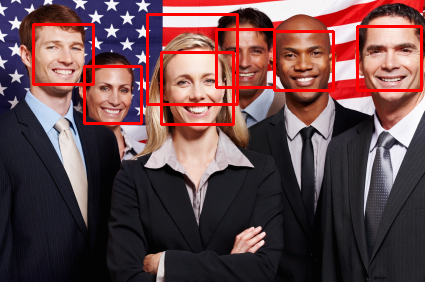

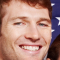

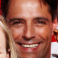

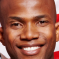

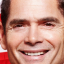

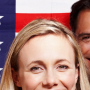

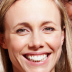

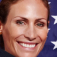

In [ ]:
img_faces = []
img_face = img.copy()

for x,y,w,h in faces:
  cv2.rectangle(img_face,(x,y),(x+w,y+h),(0,0,255),2)
  img_faces.append(img[y:y+h,x:x+w])

cv2_imshow(img_face)

for imf in img_faces:
  cv2_imshow(imf)

## การประยุกต์ใช้ OpenCV และการใช้งาน pre-trained model

- Clone Dataset

In [ ]:
!git clone https://github.com/pingkung/Face-Mask-Detection.git

fatal: destination path 'Face-Mask-Detection' already exists and is not an empty directory.


- ทดลองอ่านไฟล์ xml

In [ ]:
import cv2
import xml.etree.ElementTree as ET
tree = ET.parse('/content/Face-Mask-Detection/annotations/maksssksksss0.xml')
root = tree.getroot()
fileName = root.find('filename').text
print(fileName)

maksssksksss0.png


- สุ่มแสดงภาพจาก dataset

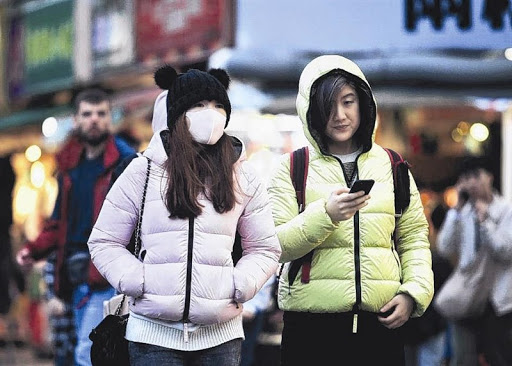

In [ ]:
import cv2
import os
from google.colab.patches import cv2_imshow

img = cv2.imread(os.path.join('/content/Face-Mask-Detection/images', fileName))
cv2_imshow(img)

- แสดงผล boundingbox ที่อ่านค่ามาได้จาก xml

In [ ]:
for obj in root.iter('object'):
    bndbox = obj.find('bndbox')
    xmin = int(bndbox.find('xmin').text)
    ymin = int(bndbox.find('ymin').text)
    xmax = int(bndbox.find('xmax').text)
    ymax = int(bndbox.find('ymax').text)
    name = obj.find('name').text
    print(name)
    print(xmin, ymin, xmax, ymax)

without_mask
79 105 109 142
with_mask
185 100 226 144
without_mask
325 90 360 141


- แสดงผลรวมระหว่างภาพใน dataset และ data annotation

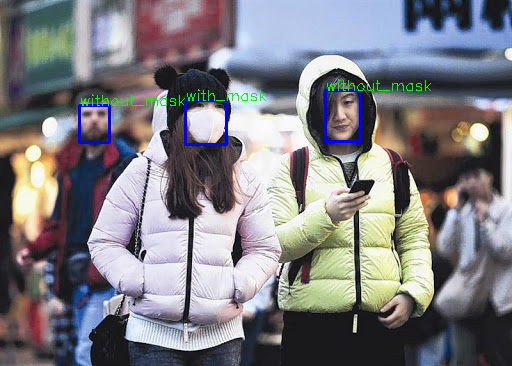

In [ ]:
labelImg = img.copy()
for obj in root.iter('object'):
    bndbox = obj.find('bndbox')
    xmin = int(bndbox.find('xmin').text)
    ymin = int(bndbox.find('ymin').text)
    xmax = int(bndbox.find('xmax').text)
    ymax = int(bndbox.find('ymax').text)
    name = obj.find('name').text
    cv2.rectangle(labelImg, (xmin, ymin), (xmax, ymax), (255,0,0), 2)
    cv2.putText(labelImg, name, (xmin, ymin), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,255,0), 1)

cv2_imshow(labelImg)

- สร้าง Directory สำหรับเก็บ Dataset ใหม่

In [ ]:
!rm -rf  /content/faceMaskDataset

!mkdir /content/faceMaskDataset
!mkdir /content/faceMaskDataset/mask_weared_incorrect
!mkdir /content/faceMaskDataset/with_mask
!mkdir /content/faceMaskDataset/without_mask

- ทดลอง save ข้อมูล

In [ ]:
i = 0
for obj in root.iter('object'):
    bndbox = obj.find('bndbox')
    xmin = int(bndbox.find('xmin').text)
    ymin = int(bndbox.find('ymin').text)
    xmax = int(bndbox.find('xmax').text)
    ymax = int(bndbox.find('ymax').text)
    name = obj.find('name').text

    face = img[ymin:ymax, xmin:xmax]
    path = '/content/faceMaskDataset/' + name + '/' + fileName.split('.')[0] + '_' + str(i) + '.png'
    cv2.imwrite(path, face)
    i +=1

- ทำการสร้าง dataset ใหม่จาก dataset ที่ clone มา

In [ ]:
import os
import cv2
import xml.etree.ElementTree as ET

annotationPath = '/content/Face-Mask-Detection/annotations'

xmls = os.listdir(annotationPath)

for xml in xmls:
  xmlPath = os.path.join(annotationPath, xml)
  tree = ET.parse(xmlPath)
  root = tree.getroot()

  fileName = root.find('filename').text

  img = cv2.imread(os.path.join('/content/Face-Mask-Detection/images', fileName))

  i = 0
  for obj in root.iter('object'):
      bndbox = obj.find('bndbox')
      xmin = int(bndbox.find('xmin').text)
      ymin = int(bndbox.find('ymin').text)
      xmax = int(bndbox.find('xmax').text)
      ymax = int(bndbox.find('ymax').text)
      name = obj.find('name').text

      face = img[ymin:ymax, xmin:xmax]
      path = '/content/faceMaskDataset/' + name + '/' + fileName.split('.')[0] + '_' + str(i) + '.png'
      if face.size != 0:
        cv2.imwrite(path, face)
        i +=1

- อ่าน dataset โดยใช้ `image_dataset_from_directory`

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Create an ImageDataGenerator object
train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)  # added validation split

# Load images from a directory
data_dir = '/content/faceMaskDataset'
img_height = 64
img_width = 64
batch_size = 32

train_ds = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

val_ds = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

Found 3259 images belonging to 3 classes.
Found 813 images belonging to 3 classes.


In [ ]:
train_ds.class_indices

{'mask_weared_incorrect': 0, 'with_mask': 1, 'without_mask': 2}

In [ ]:
train_ds.class_indices.keys()

dict_keys(['mask_weared_incorrect', 'with_mask', 'without_mask'])

In [ ]:
print("Class names in the dataset: ", list(train_ds.class_indices.keys()))

Class names in the dataset:  ['mask_weared_incorrect', 'with_mask', 'without_mask']


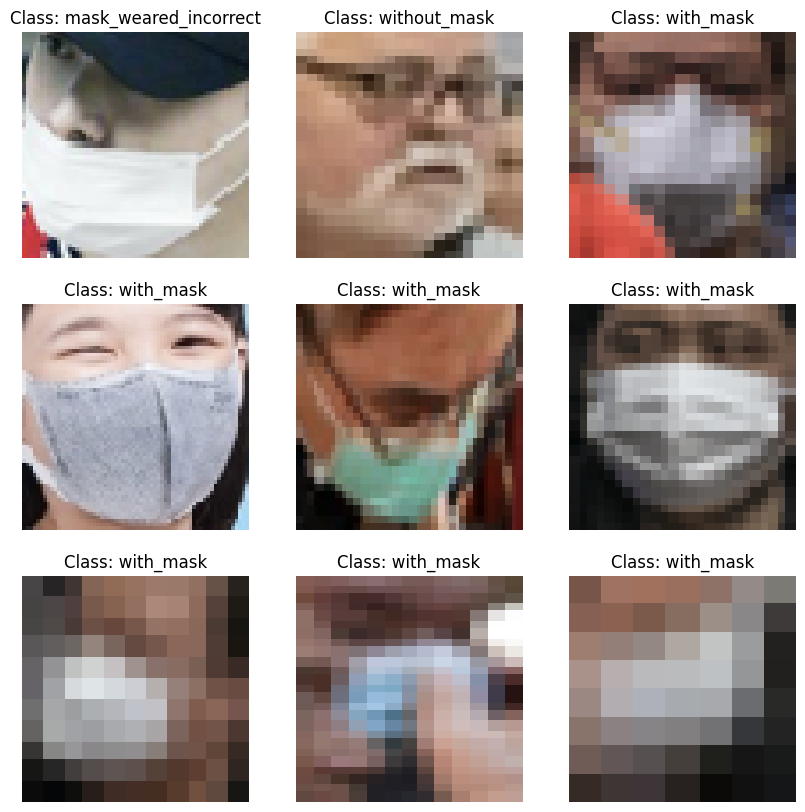

In [ ]:
import matplotlib.pyplot as plt

x_batch, y_batch = next(train_ds)

plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(x_batch[i])
    class_index = np.argmax(y_batch[i])
    class_name = list(train_ds.class_indices.keys())[class_index]
    plt.title('Class: ' + class_name)
    plt.axis("off")

- Load pre-trained model [pre-trained model](https://keras.io/api/applications/)

In [ ]:
from tensorflow.keras.applications import MobileNetV3Small

mobilenet = MobileNetV3Small(weights='imagenet', include_top=False, input_shape=(64,64,3))

4334752/4334752 [==============================] - 0s 0us/step


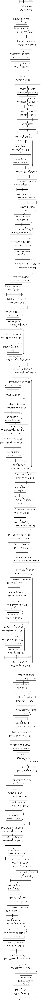

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(mobilenet, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
mobilenet.summary()

- Freeze layers

In [ ]:
for layer in mobilenet.layers:
  layer.trainable = False

In [ ]:
mobilenet.summary()

- Add rescale layer and lassification layer

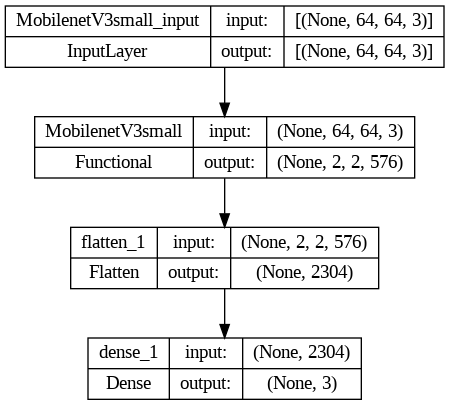

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.utils import plot_model

model = Sequential()
model.add(mobilenet)
model.add(Flatten())
model.add(Dense(3,activation='softmax'))

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
model.compile(optimizer="adam",loss="categorical_crossentropy",metrics ="accuracy")

In [ ]:
history = model.fit(train_ds, epochs=30, validation_data=val_ds)

Epoch 1/30
102/102 [==============================] - 12s 80ms/step - loss: 0.6166 - accuracy: 0.7858 - val_loss: 0.5846 - val_accuracy: 0.7946
Epoch 2/30
102/102 [==============================] - 6s 59ms/step - loss: 0.5959 - accuracy: 0.7935 - val_loss: 0.5742 - val_accuracy: 0.7946
Epoch 3/30
102/102 [==============================] - 6s 57ms/step - loss: 0.5818 - accuracy: 0.7935 - val_loss: 0.5755 - val_accuracy: 0.7946
Epoch 4/30
102/102 [==============================] - 6s 57ms/step - loss: 0.5751 - accuracy: 0.7935 - val_loss: 0.5582 - val_accuracy: 0.7946
Epoch 5/30
102/102 [==============================] - 6s 61ms/step - loss: 0.5716 - accuracy: 0.7941 - val_loss: 0.5598 - val_accuracy: 0.7946
Epoch 6/30
102/102 [==============================] - 7s 70ms/step - loss: 0.5646 - accuracy: 0.7926 - val_loss: 0.5571 - val_accuracy: 0.7946
Epoch 7/30
102/102 [==============================] - 7s 67ms/step - loss: 0.5488 - accuracy: 0.7935 - val_loss: 0.5532 - val_accuracy: 0.794

In [ ]:
from tensorflow.keras.models import load_model
# model.save('trainedModel.h5')

loadModel = load_model('trainedModel.h5')
loadModel.summary()


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 MobilenetV3small (Function  (None, 2, 2, 576)         939120    
 al)                                                             
                                                                 
 flatten_1 (Flatten)         (None, 2304)              0         
                                                                 
 dense_1 (Dense)             (None, 3)                 6915      
                                                                 
Total params: 946035 (3.61 MB)
Trainable params: 6915 (27.01 KB)
Non-trainable params: 939120 (3.58 MB)
_________________________________________________________________


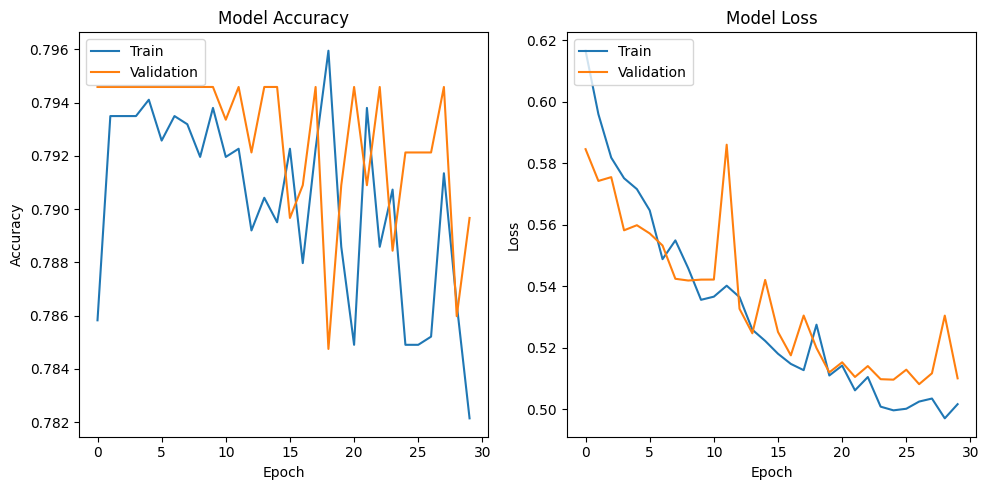

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()

1/1 [==============================] - 1s 1s/step


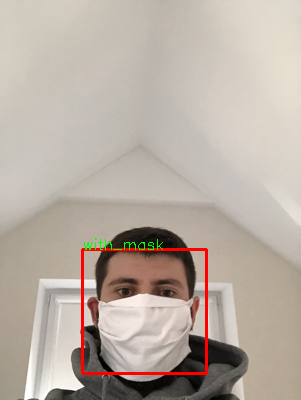

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

testImg = cv2.imread('/content/Face-Mask-Detection/images/maksssksksss10.png')
testImgGray = cv2.cvtColor(testImg, cv2.IMREAD_GRAYSCALE)

face_model = cv2.CascadeClassifier('/content/Face-Mask-Detection/haarcascade_frontalface_default.xml')

faces = face_model.detectMultiScale(testImgGray,scaleFactor=1.1, minNeighbors=3)

testImgOutput = testImg.copy()
for (x,y,w,h) in faces:
    cv2.rectangle(testImgOutput,(x,y),(x+w,y+h),(0,0,255),2)
    face = testImg[y:y+h, x:x+w]

    face = cv2.resize(face, (64,64))
    y_pred = model.predict(np.expand_dims(face/255.0, axis=0)) #(None, 64, 64, 3)
    classIndex = np.argmax(y_pred[0])
    cv2.putText(testImgOutput, list(train_ds.class_indices.keys())[classIndex], (x, y), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,255,0), 1)



cv2_imshow(testImgOutput)

### แบบฝึกหัดที่ 3

ทดลองสร้าง CNN model เพื่อทำนายว่า กระบวนการ Print ของ 3D Printer นั้น บกพร่องหรือไม่

In [ ]:
!git clone https://github.com/pingkung/3D-Printer-Defected-Dataset.git

Cloning into '3D-Printer-Defected-Dataset'...
remote: Enumerating objects: 1568, done.
remote: Counting objects: 100% (6/6), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 1568 (delta 1), reused 6 (delta 1), pack-reused 1562
Receiving objects: 100% (1568/1568), 52.59 MiB | 31.83 MiB/s, done.
Resolving deltas: 100% (1/1), done.


In [ ]:
!ls -al /content/3D-Printer-Defected-Dataset

total 80
drwxr-xr-x 4 root root  4096 Jan 27 06:25 .
drwxr-xr-x 1 root root  4096 Jan 27 06:23 ..
drwxr-xr-x 2 root root 36864 Jan 27 06:23 defected
drwxr-xr-x 2 root root 36864 Jan 27 06:23 no_defected


In [ ]:
!rm /content/3D-Printer-Defected-Dataset/README.md
!rm -rf /content/3D-Printer-Defected-Dataset/.git

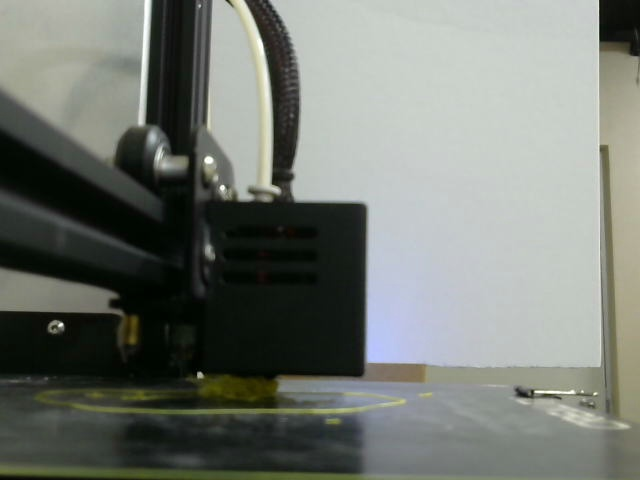

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

sample = cv2.imread('/content/3D-Printer-Defected-Dataset/defected/bed_not_stick_0.jpg')
cv2_imshow(sample)

In [ ]:
sample.shape

(480, 640, 3)

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

dataGen = ImageDataGenerator(rescale=1./255,
                             shear_range=0.2,
                             zoom_range=0.2,
                             rotation_range=20,
                             horizontal_flip=True,
                             validation_split=0.2)

In [ ]:
train_ds = dataGen.flow_from_directory(
    '/content/3D-Printer-Defected-Dataset',
    target_size=(128,128),
    batch_size=32,
    class_mode='categorical',
    subset='training'
)

Found 1247 images belonging to 2 classes.


In [ ]:
val_ds = dataGen.flow_from_directory(
    '/content/3D-Printer-Defected-Dataset',
    target_size=(128,128),
    batch_size=32,
    class_mode='categorical',
    subset='validation'
)

Found 310 images belonging to 2 classes.


In [ ]:
a = [1,2,3]
b = [4,5,6]

for x,y in zip(a,b):
  print(x,y)

1 4
2 5
3 6


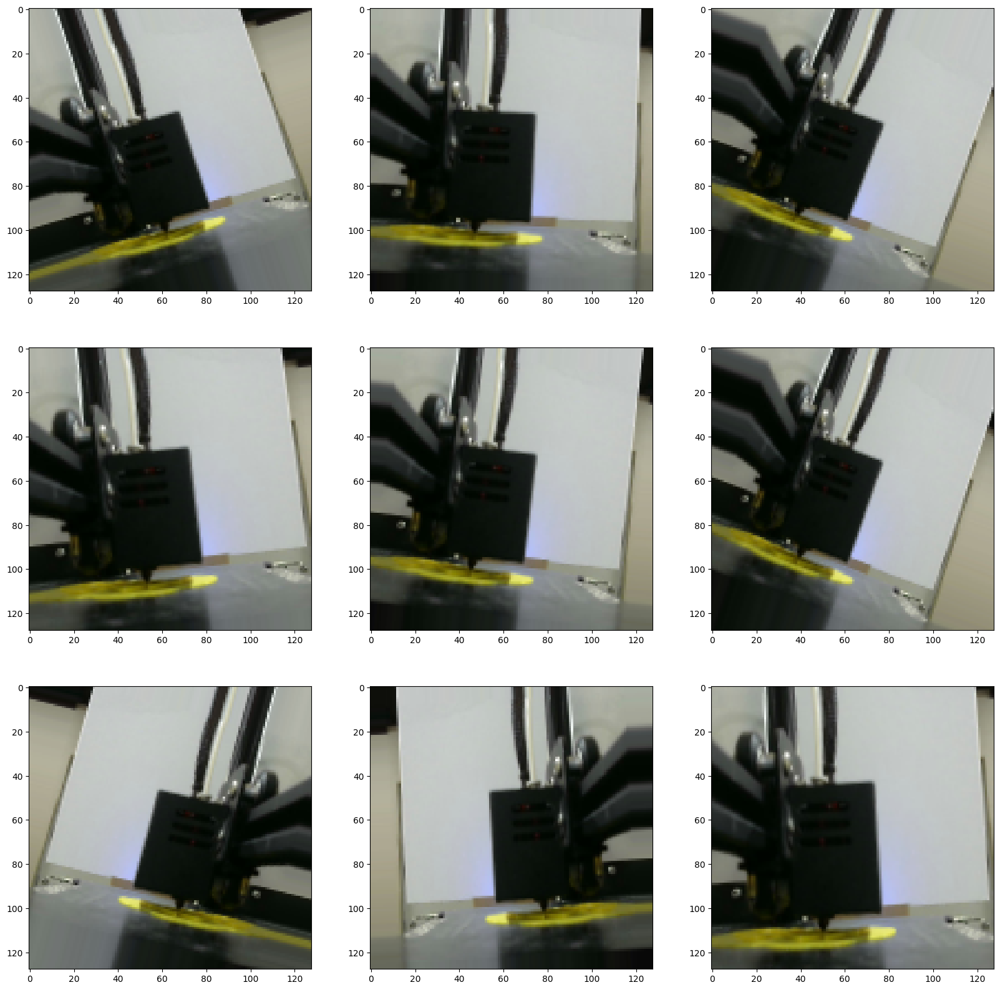

In [ ]:
import matplotlib.pyplot as plt

images = [train_ds[0][0][0] for i in range(9)]

fig, axs = plt.subplots(3,3, figsize=(20,20))
axs = axs.flatten()
for img, ax in zip(images, axs):
  ax.imshow(img)
plt.show()

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, Dense, Flatten, MaxPooling2D, Dropout

model = Sequential()
model.add(Conv2D(16, 3, padding='same', activation='relu', input_shape=(128, 128, 3)))
model.add(MaxPooling2D((2,2)))
model.add(Conv2D(32,3 , padding='same', activation='relu'))
model.add(MaxPooling2D((2,2)))
model.add(Conv2D(64,3 , padding='same', activation='relu'))
model.add(MaxPooling2D((2,2)))
mode.add(Dropout(0.2))

model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(2, activation='softmax'))

model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 128, 128, 16)      448       
                                                                 
 max_pooling2d_6 (MaxPoolin  (None, 64, 64, 16)        0         
 g2D)                                                            
                                                                 
 conv2d_10 (Conv2D)          (None, 64, 64, 32)        4640      
                                                                 
 max_pooling2d_7 (MaxPoolin  (None, 32, 32, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_11 (Conv2D)          (None, 32, 32, 64)        18496     
                                                                 
 max_pooling2d_8 (MaxPoolin  (None, 16, 16, 64)       

In [ ]:
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics='accuracy')

In [ ]:
h = model.fit(train_ds, epochs=3,  validation_data=val_ds)

Epoch 1/3
39/39 [==============================] - 37s 927ms/step - loss: 0.1563 - accuracy: 0.9366 - val_loss: 1.3777 - val_accuracy: 0.5161
Epoch 2/3
39/39 [==============================] - 40s 1s/step - loss: 0.1392 - accuracy: 0.9487 - val_loss: 1.3847 - val_accuracy: 0.5323
Epoch 3/3
39/39 [==============================] - 41s 1s/step - loss: 0.1344 - accuracy: 0.9431 - val_loss: 1.1838 - val_accuracy: 0.5548


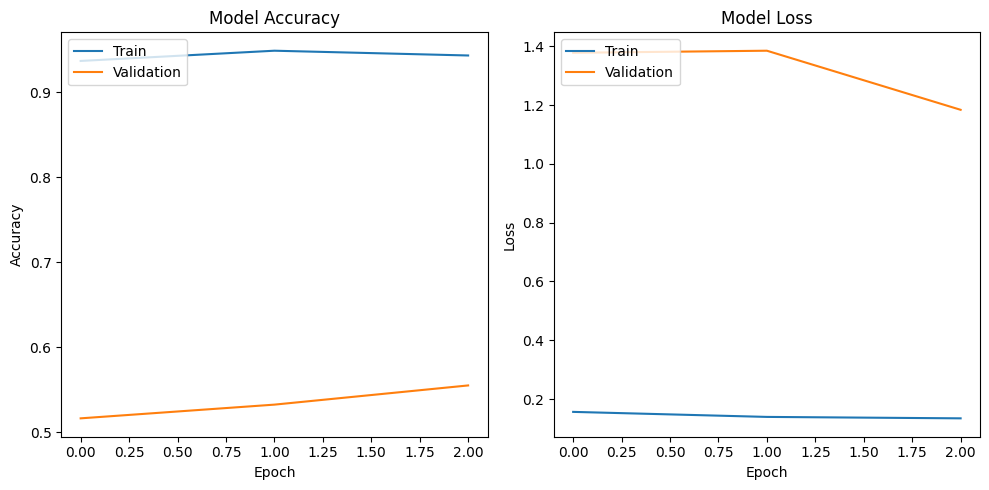

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(h.history['accuracy'])
plt.plot(h.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.subplot(1, 2, 2)
plt.plot(h.history['loss'])
plt.plot(h.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()

In [ ]:
import cv2

pre_img = cv2.imread('/content/3D-Printer-Defected-Dataset/no_defected/scratch_119.jpg')
pre_img = cv2.resize(pre_img, (128,128))
y_pred = model.predict(np.expand_dims(pre_img/255.0, axis=0))
classIndex = np.argmax(y_pred[0])
print(list(train_ds.class_indices.keys())[classIndex])

1/1 [==============================] - 0s 65ms/step
defected


## YOLOv8

YOLO หรือ You Only Look Once คือ Realtime Object Detection Model ที่มีความโดดเด่นเรื่องความเร็วและความถูกต้อง

[YOLOv8 colab tutorial](https://colab.research.google.com/github/ultralytics/ultralytics/blob/main/examples/tutorial.ipynb#scrollTo=wbvMlHd_QwMG)

[YOLOv8 Git](https://github.com/ultralytics/ultralytics)

[YOLOv8 Youtube](https://www.youtube.com/@Ultralytics/videos)

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 705.0/705.0 kB 7.2 MB/s eta 0:00:00


In [ ]:
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.1.6 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 27.2/107.7 GB disk)


In [ ]:
!nvidia-smi

/bin/bash: line 1: nvidia-smi: command not found


YOLOv8 can train, val, predict and export models for the most common tasks in vision AI: [Detect](https://docs.ultralytics.com/tasks/detect/), [Segment](https://docs.ultralytics.com/tasks/segment/), [Classify](https://docs.ultralytics.com/tasks/classify/) and [Pose](https://docs.ultralytics.com/tasks/pose/). See [YOLOv8 Tasks Docs](https://docs.ultralytics.com/tasks/) for more information.

<br><img width="1024" src="https://raw.githubusercontent.com/ultralytics/assets/main/im/banner-tasks.png">

#### What is the COCO dataset?
The COCO (Common Objects in Context) dataset is a large-scale image recognition dataset for object detection, segmentation, and captioning tasks. It contains over 330,000 images, each annotated with 80 object categories and 5 captions describing the scene. The COCO dataset is widely used in computer vision research and has been used to train and evaluate many state-of-the-art object detection and segmentation models.

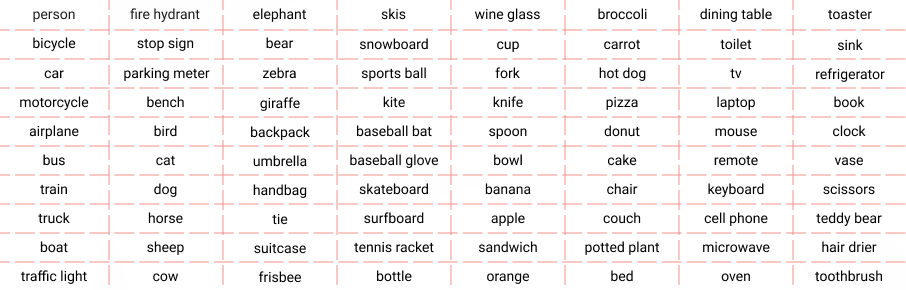

### Detection

YOLOv8 _detection_ models have no suffix and are the default YOLOv8 models, i.e. `yolov8n.pt` and are pretrained on COCO. See [Detection Docs](https://docs.ultralytics.com/tasks/detect/) for full details.


In [ ]:
# Load YOLOv8n, train it on COCO128 for 3 epochs and predict an image with it
from ultralytics import YOLO

model = YOLO('yolov8n.pt')  # load a pretrained YOLOv8n detection model
# model.train(data='coco128.yaml', epochs=3)  # train the model
results = model('https://ultralytics.com/images/bus.jpg')  # predict on an image

100%|██████████| 6.23M/6.23M [00:00<00:00, 73.9MB/s]


100%|██████████| 476k/476k [00:00<00:00, 12.4MB/s]


image 1/1 /content/bus.jpg: 640x480 4 persons, 1 bus, 1 stop sign, 390.9ms
Speed: 11.3ms preprocess, 390.9ms inference, 35.0ms postprocess per image at shape (1, 3, 640, 480)


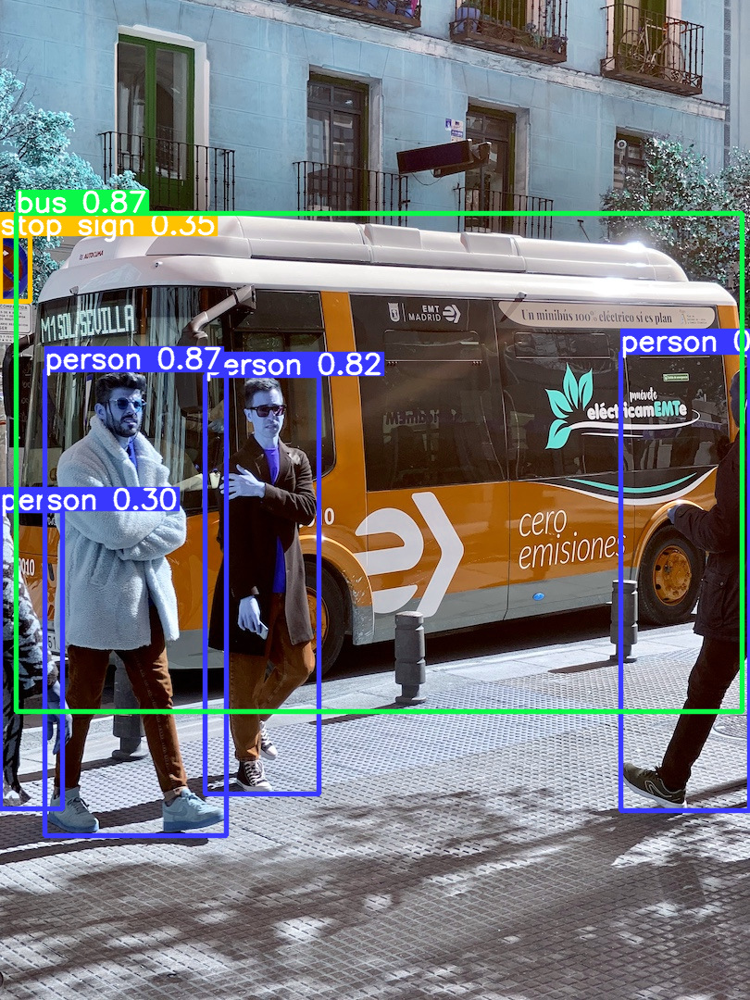

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

result = results[0]
img_array = np.array(result.plot())[:,:,::-1]
cv2_imshow(img_array)

### Segmentation

YOLOv8 _segmentation_ models use the `-seg` suffix, i.e. `yolov8n-seg.pt` and are pretrained on COCO. See [Segmentation Docs](https://docs.ultralytics.com/tasks/segment/) for full details.


In [ ]:
# Load YOLOv8n-seg, train it on COCO128-seg for 3 epochs and predict an image with it
from ultralytics import YOLO

model = YOLO('yolov8n-seg.pt')  # load a pretrained YOLOv8n segmentation model
# model.train(data='coco128-seg.yaml', epochs=3)  # train the model
results = model('https://ultralytics.com/images/bus.jpg')  # predict on an image

100%|██████████| 6.73M/6.73M [00:00<00:00, 80.6MB/s]



Found https://ultralytics.com/images/bus.jpg locally at bus.jpg
image 1/1 /content/bus.jpg: 640x480 4 persons, 1 bus, 1 skateboard, 325.7ms
Speed: 6.3ms preprocess, 325.7ms inference, 34.9ms postprocess per image at shape (1, 3, 640, 480)


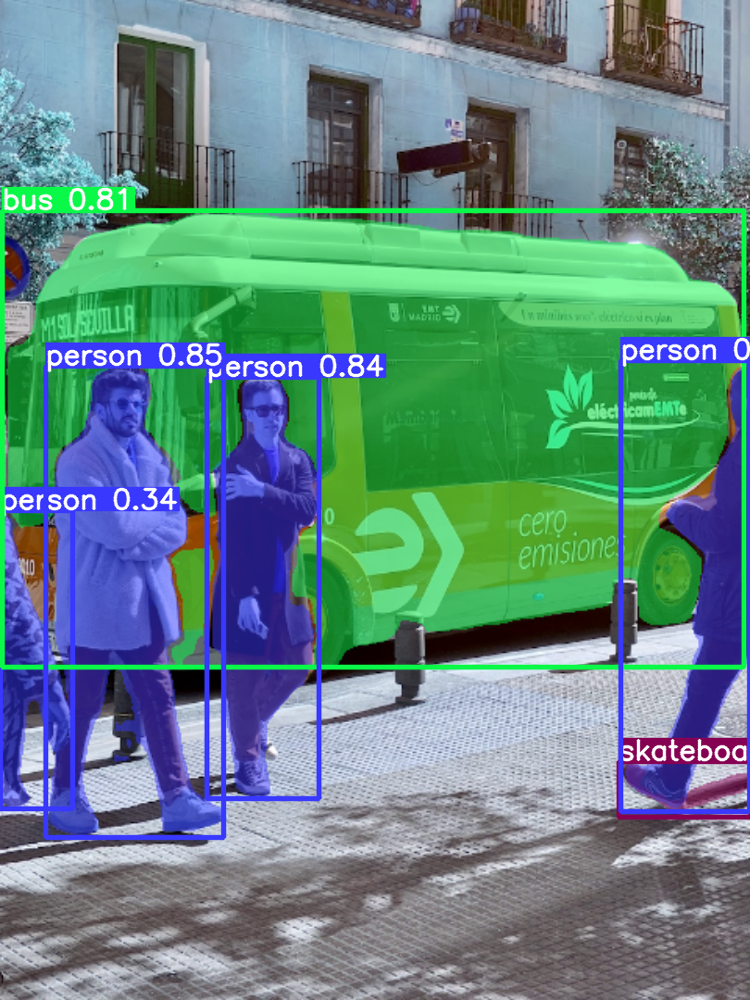

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

result = results[0]
img_array = np.array(result.plot())[:,:,::-1]
cv2_imshow(img_array)

### Classification

YOLOv8 _classification_ models use the `-cls` suffix, i.e. `yolov8n-cls.pt` and are pretrained on ImageNet. See [Classification Docs](https://docs.ultralytics.com/tasks/classify/) for full details.

In [ ]:
# Load YOLOv8n-cls, train it on mnist160 for 3 epochs and predict an image with it
from ultralytics import YOLO

model = YOLO('yolov8n-cls.pt')  # load a pretrained YOLOv8n classification model
# model.train(data='mnist160', epochs=3)  # train the model
results = model('https://ultralytics.com/images/bus.jpg')  # predict on an image

100%|██████████| 5.30M/5.30M [00:00<00:00, 69.5MB/s]



Found https://ultralytics.com/images/bus.jpg locally at bus.jpg
image 1/1 /content/bus.jpg: 224x224 minibus 0.54, police_van 0.24, trolleybus 0.06, golfcart 0.02, streetcar 0.02, 35.5ms
Speed: 19.8ms preprocess, 35.5ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)


100%|██████████| 755k/755k [00:00<00:00, 16.6MB/s]


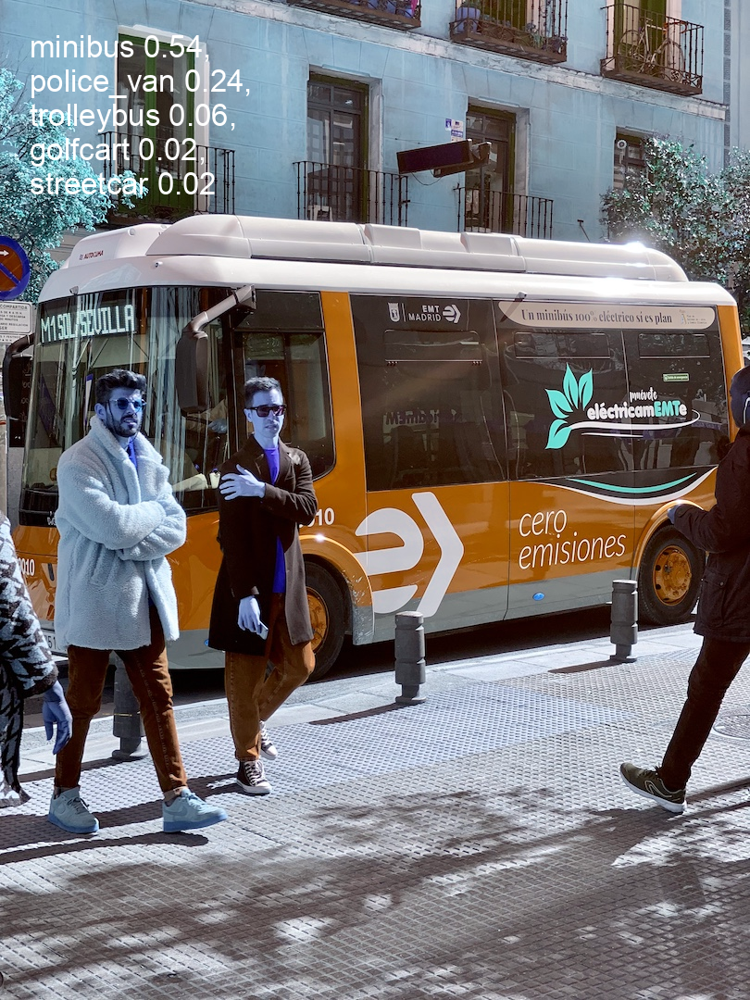

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

result = results[0]
img_array = np.array(result.plot())[:,:,::-1]
cv2_imshow(img_array)

### Pose

YOLOv8 _pose_ models use the `-pose` suffix, i.e. `yolov8n-pose.pt` and are pretrained on COCO Keypoints. See [Pose Docs](https://docs.ultralytics.com/tasks/pose/) for full details.

In [ ]:
# Load YOLOv8n-pose, train it on COCO8-pose for 3 epochs and predict an image with it
from ultralytics import YOLO

model = YOLO('yolov8n-pose.pt')  # load a pretrained YOLOv8n classification model
# model.train(data='coco8-pose.yaml', epochs=3)  # train the model
results = model('https://ultralytics.com/images/bus.jpg')  # predict on an image

100%|██████████| 6.51M/6.51M [00:00<00:00, 77.8MB/s]



Found https://ultralytics.com/images/bus.jpg locally at bus.jpg
image 1/1 /content/bus.jpg: 640x480 4 persons, 283.1ms
Speed: 5.4ms preprocess, 283.1ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 480)


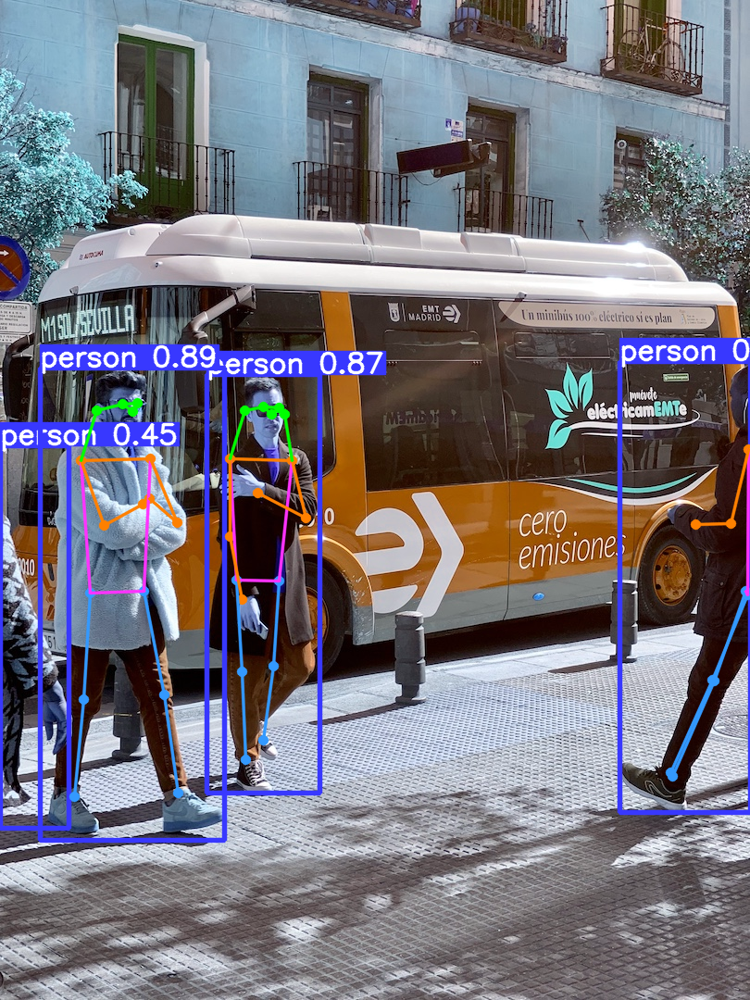

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

result = results[0]
img_array = np.array(result.plot())[:,:,::-1]
cv2_imshow(img_array)

### Results

[Working with Results](https://docs.ultralytics.com/modes/predict/#working-with-results)

### Detection Results

In [ ]:
# Load YOLOv8n, train it on COCO128 for 3 epochs and predict an image with it
from ultralytics import YOLO

model = YOLO('yolov8n.pt')  # load a pretrained YOLOv8n detection model
# model.train(data='coco128.yaml', epochs=3)  # train the model
results = model('https://images.ctfassets.net/sfnkq8lmu5d7/4Zy5HnvSQtxucbgvkAn04e/2f47ddf3b9e27592a216288f2d8ef898/2021-11-16_Jason_Wu_Cat_Person.jpg')  # predict on an image

100%|██████████| 61.4k/61.4k [00:00<00:00, 3.33MB/s]


image 1/1 /content/2021-11-16_Jason_Wu_Cat_Person.jpg: 480x640 1 person, 1 cat, 1 bowl, 376.1ms
Speed: 10.3ms preprocess, 376.1ms inference, 2.4ms postprocess per image at shape (1, 3, 480, 640)


In [ ]:
print(results)

[ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant'

In [ ]:
for result in results:
  boxes = result.boxes.cpu().numpy()
  xyxys = boxes.xyxy
  xyxys = xyxys.astype(int)

  print(xyxys)

[[616 514 757 584]
 [ 83 373 728 632]
 [ 30 104 446 610]]


person
[         45          15           0]


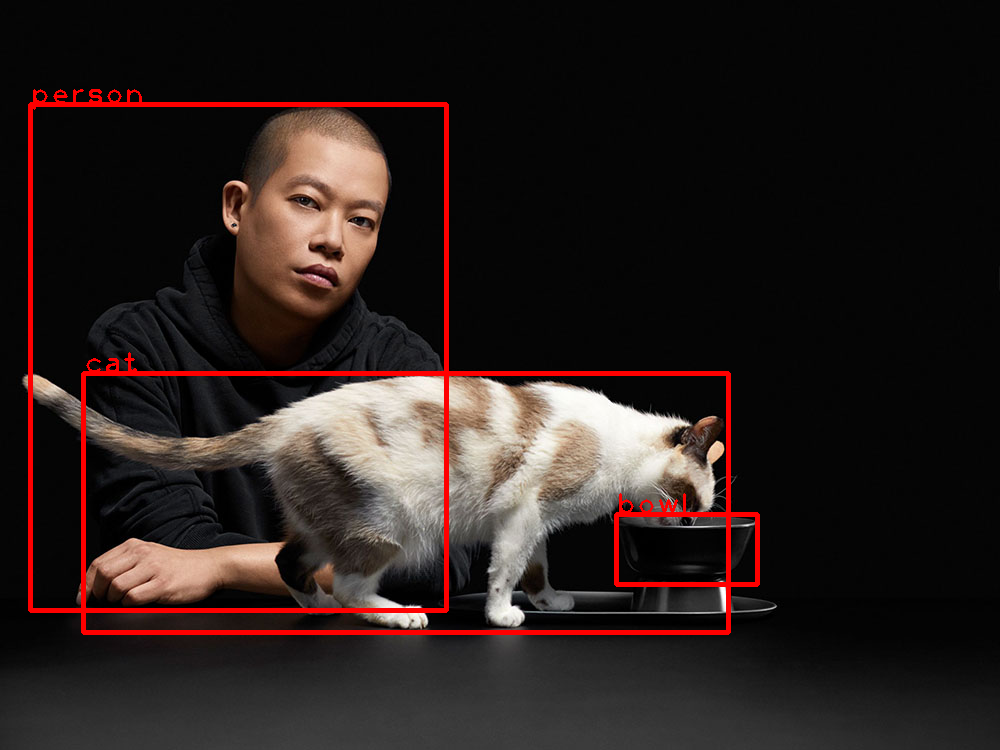

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/2021-11-16_Jason_Wu_Cat_Person.jpg')

imgRes = img.copy()
for result in results:
  print(result.names[0])
  boxes = result.boxes.cpu().numpy()
  print(boxes.cls)
  xyxys = boxes.xyxy
  xyxys = xyxys.astype(int)
  for xyxy, clsIndex in zip(xyxys, boxes.cls):
    cv2.rectangle(imgRes, (xyxy[0],xyxy[1]), (xyxy[2],xyxy[3]), (0,0,255), 3)
    cv2.putText(imgRes, result.names[clsIndex], (xyxy[0],xyxy[1]), cv2.FONT_HERSHEY_PLAIN, 2, (0,0,255), 2)

  cv2_imshow(imgRes)

### Segmentation Results

In [ ]:
# Load YOLOv8n-seg, train it on COCO128-seg for 3 epochs and predict an image with it
from ultralytics import YOLO

model = YOLO('yolov8n-seg.pt')  # load a pretrained YOLOv8n segmentation model
# model.train(data='coco128-seg.yaml', epochs=3)  # train the model
results = model('https://upload.wikimedia.org/wikipedia/commons/thumb/1/15/Cat_August_2010-4.jpg/1200px-Cat_August_2010-4.jpg')  # predict on an image

100%|██████████| 136k/136k [00:00<00:00, 4.29MB/s]


image 1/1 /content/1200px-Cat_August_2010-4.jpg: 416x640 2 cats, 291.7ms
Speed: 4.4ms preprocess, 291.7ms inference, 11.1ms postprocess per image at shape (1, 3, 416, 640)


In [ ]:
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread('/content/1200px-Cat_August_2010-4.jpg')
print(img.shape)
# cv2_imshow(img)

(734, 1200, 3)


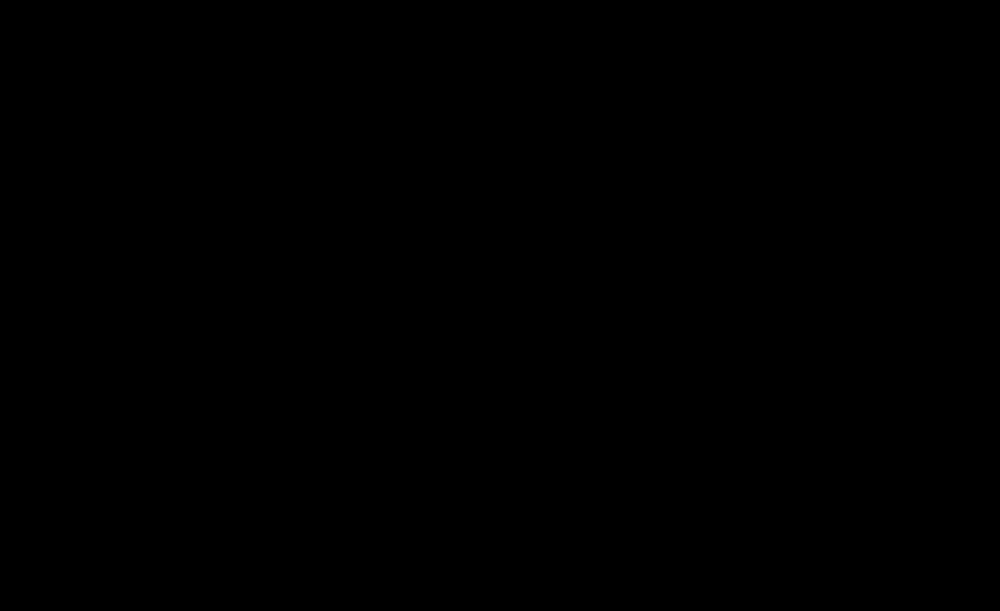

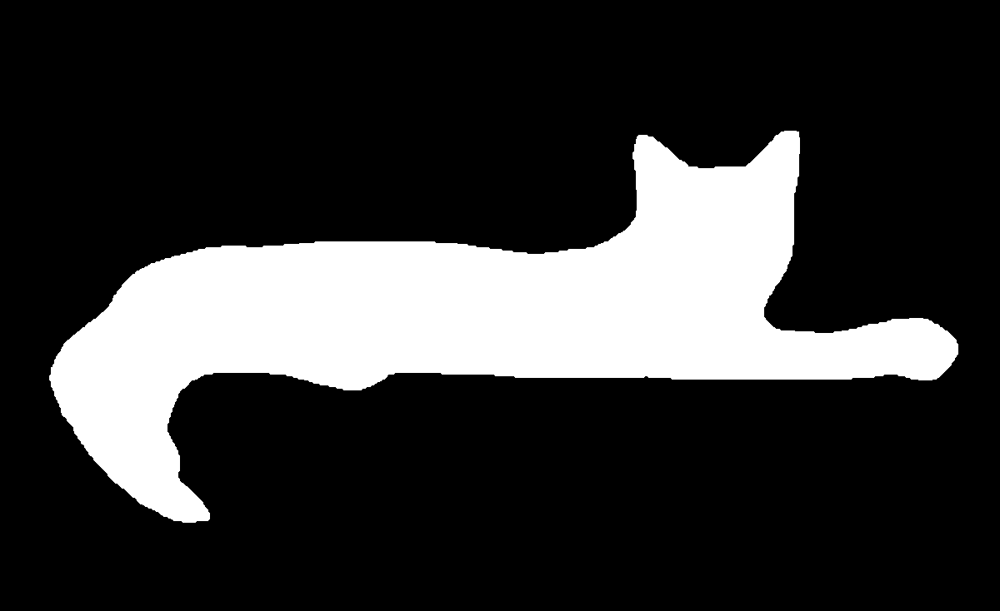

In [ ]:
import numpy as np

maskImg = np.zeros((img.shape[0], img.shape[1]), dtype=np.uint8)
cv2_imshow(maskImg)

for result in results:
  for mask in result.masks.xy:
    mask = mask.astype(int)
    cv2.fillPoly(maskImg, [mask], 255)

cv2_imshow(maskImg)

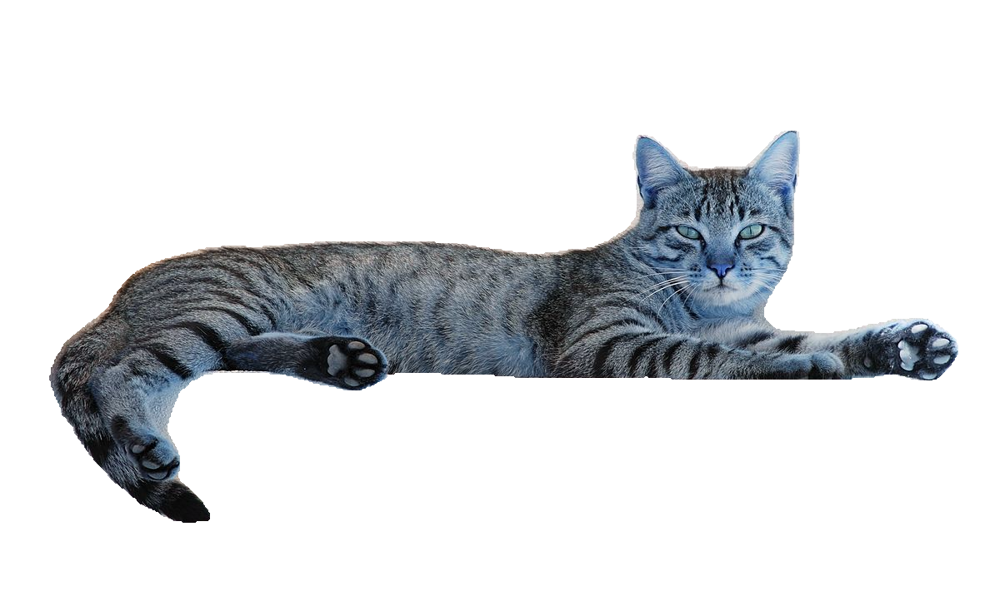

In [ ]:
cat = img.copy()

cat = cv2.cvtColor(cat, cv2.COLOR_BGR2RGBA)
cat[:, :, 3] = maskImg

cv2_imshow(cat)

### Custom dataset

1. Online data annotation using [roboflow](https://roboflow.com/)
  
  - [Roboflow Getting Started Video](https://www.youtube.com/watch?v=a3SBRtILjPI)

2. Offline data annotation using [labelImg](https://pypi.org/project/labelImg/)

[Example Dataset](https://universe.roboflow.com/evankim9903-gmail-com/gauge_detection)

In [ ]:
!unzip /content/gauge.v4-release-640.yolov8.zip -d guageDataset

Archive:  /content/gauge.v4-release-640.yolov8.zip
 extracting: guageDataset/README.dataset.txt  
 extracting: guageDataset/README.roboflow.txt  
 extracting: guageDataset/data.yaml  
   creating: guageDataset/test/
   creating: guageDataset/test/images/
 extracting: guageDataset/test/images/112_PNG_jpg.rf.648fe1cd42b798f2c1cf4f1fe6c54b51.jpg  
 extracting: guageDataset/test/images/115_PNG_jpg.rf.b091791dfc2f46acb5e72b2ef639ebe2.jpg  
 extracting: guageDataset/test/images/116_PNG_jpg.rf.edd710223247b81b4b18cded5dd7ea3b.jpg  
 extracting: guageDataset/test/images/119_PNG_jpg.rf.635ac3778e4aa468f2f9448e0a9e52cd.jpg  
 extracting: guageDataset/test/images/123_PNG_jpg.rf.87cc8917d97ad9352f9080870402ad6f.jpg  
 extracting: guageDataset/test/images/129_PNG_jpg.rf.c933af958cb0707936b16fc892bb57ca.jpg  
 extracting: guageDataset/test/images/130_PNG_jpg.rf.dc1c6b5a254654b17ea8ce338d18b1a7.jpg  
 extracting: guageDataset/test/images/132_PNG_jpg.rf.dfaa8f39269efc4b0ac30c5ef61f9a63.jpg  
 extracti

In [ ]:
!yolo task=detect mode=train model=yolov8n.pt data=/content/guageDataset/data.yaml epochs=4 imgsz=640

Ultralytics YOLOv8.1.6 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/guageDataset/data.yaml, epochs=4, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_b


image 1/1 /content/guageDataset/test/images/161_PNG_jpg.rf.7bd623de2b6dd40123eed8f4cd6e642e.jpg: 640x640 1 gauges, 470.2ms
Speed: 3.2ms preprocess, 470.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


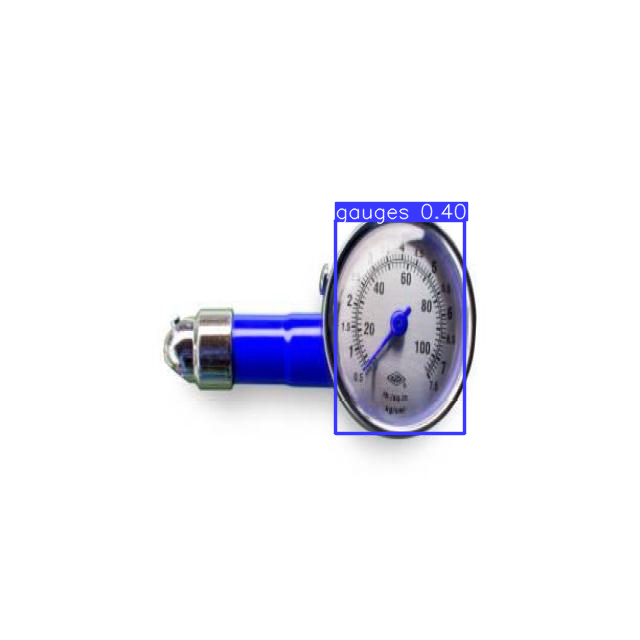

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

# Load YOLOv8n, train it on COCO128 for 3 epochs and predict an image with it
from ultralytics import YOLO

model = YOLO('/content/runs/detect/train/weights/best.pt')  # load a pretrained YOLOv8n detection model
# model.train(data='coco128.yaml', epochs=3)  # train the model
results = model('/content/guageDataset/test/images/161_PNG_jpg.rf.7bd623de2b6dd40123eed8f4cd6e642e.jpg')  # predict on an image

result = results[0]
img_array = np.array(result.plot())[:,:,::-1]
cv2_imshow(img_array)

In [ ]:
!unzip /content/Face-Mask.v1i.yolov8.zip -d faceMask

Archive:  /content/Face-Mask.v1i.yolov8.zip
 extracting: faceMask/README.dataset.txt  
 extracting: faceMask/README.roboflow.txt  
 extracting: faceMask/data.yaml      
   creating: faceMask/test/
   creating: faceMask/test/images/
 extracting: faceMask/test/images/maksssksksss104_png.rf.3413058e8c7f45db78622939a4b5d048.jpg  
 extracting: faceMask/test/images/maksssksksss122_png.rf.8799e02d5f9b185f1720cb72cf1c4ccd.jpg  
 extracting: faceMask/test/images/maksssksksss12_png.rf.c84750ae4f0b7d5c3ef70b34d13d75ee.jpg  
 extracting: faceMask/test/images/maksssksksss176_png.rf.dfdceb2f84ae68b3fbcc0c19af66519e.jpg  
 extracting: faceMask/test/images/maksssksksss192_png.rf.3917b519017696357bc8cf84e5be43b6.jpg  
 extracting: faceMask/test/images/maksssksksss19_png.rf.5403a8f27d10c80c2247ddac5a7821fd.jpg  
 extracting: faceMask/test/images/maksssksksss206_png.rf.5163d9fdb261f44c6ead4a33fe8b2a90.jpg  
 extracting: faceMask/test/images/maksssksksss230_png.rf.eb5565b5af60050842904a3ef59be154.jpg  
 e

In [ ]:
!yolo task=detect mode=train model=yolov8n.pt data=/content/faceMask/data.yaml epochs=1 imgsz=640

Ultralytics YOLOv8.1.6 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/faceMask/data.yaml, epochs=1, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxe


image 1/1 /content/faceMask/test/images/maksssksksss773_png.rf.ad11fb704f728862293cbaeb436faf84.jpg: 640x640 (no detections), 462.3ms
Speed: 16.8ms preprocess, 462.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


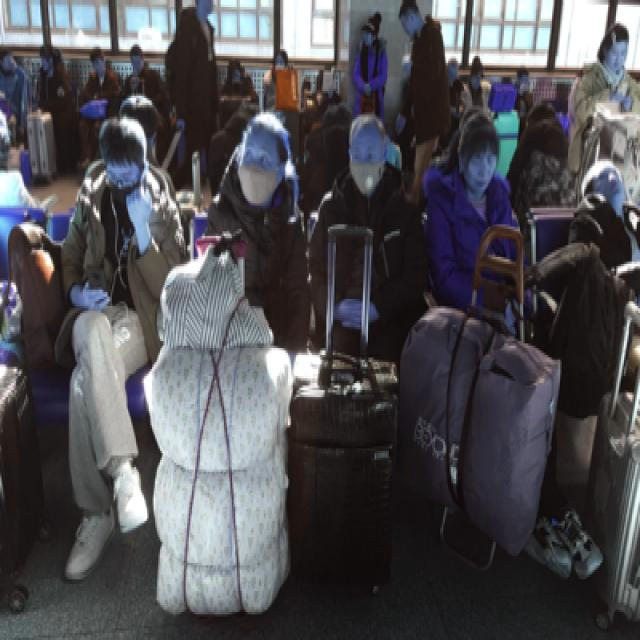

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

# Load YOLOv8n, train it on COCO128 for 3 epochs and predict an image with it
from ultralytics import YOLO

model = YOLO('/content/runs/detect/train2/weights/best.pt')  # load a pretrained YOLOv8n detection model
# model.train(data='coco128.yaml', epochs=3)  # train the model
results = model('/content/faceMask/test/images/maksssksksss773_png.rf.ad11fb704f728862293cbaeb436faf84.jpg')  # predict on an image

result = results[0]
img_array = np.array(result.plot())[:,:,::-1]
cv2_imshow(img_array)